In [46]:
# Standard plotly imports
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot
# Using cufflinks in offline mode
import cufflinks
cufflinks.go_offline()
# Set the global theme for cufflinks
cufflinks.set_config_file(world_readable=True, theme='pearl', offline=True)

In [16]:
# Standard Data Science Helpers
import numpy as np
import pandas as pd
import scipy

import featuretools as ft

# Graphic libraries
import matplotlib as plt
%matplotlib inline
plt.style.use('fivethirtyeight');plt.rcParams['font.size']=18
import seaborn as sns

# Extra options
pd.options.display.max_rows = 10
# Show all code cells outputs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import cufflinks
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')

In [9]:
df = pd.read_parquet('2019-01-13_stats').reset_index().rename(columns={'date': 'ds', 'views': 'y'})
df.head()

,ds,y
0,2017-06-10,48.0
1,2017-06-11,49.0
2,2017-06-12,2.0
3,2017-06-13,3.0
4,2017-06-14,5.0


In [6]:
import fbprophet

In [7]:
model = fbprophet.Prophet()

In [10]:
model.fit(df)

INFO:fbprophet.forecaster:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet.forecaster:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\willk\Anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  elif np.issubdtype(np.asarray(v).dtype, float):


In [11]:
df_future = model.make_future_dataframe(periods=365)

In [13]:
df_predicted = model.predict(df_future)

In [28]:
df_predicted.columns

Index(['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
       'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
       'weekly', 'weekly_lower', 'weekly_upper', 'multiplicative_terms',
       'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat'],
      dtype='object')

In [29]:
df_predicted.iplot(x='ds', y='yhat', secondary_y='yhat_upper')

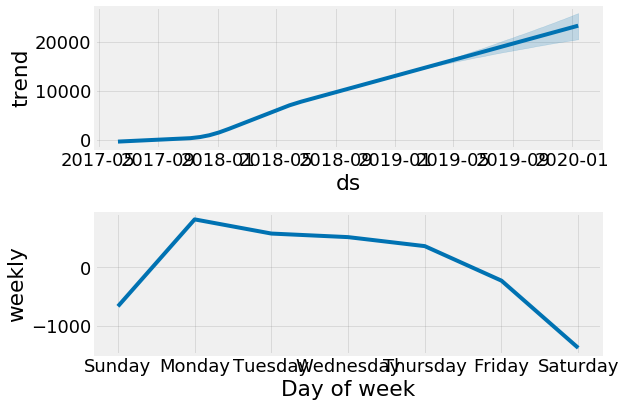

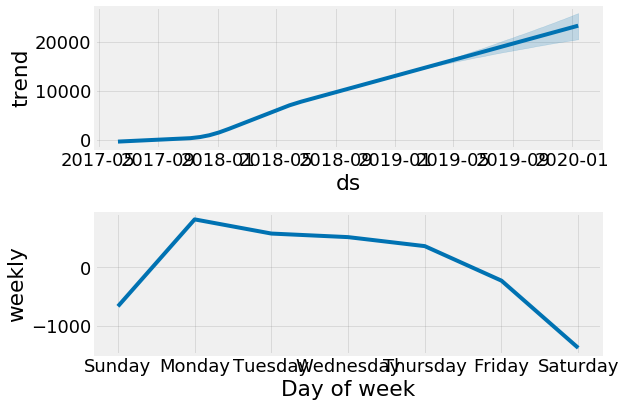

In [27]:
fbprophet.plot.plot_components(model, df_predicted)

C:\Users\willk\Anaconda3\lib\site-packages\fbprophet\forecaster.py:1425: DeprecationWarning:

This method will be removed in the next version. Please use fbprophet.plot.plot_forecast_component. 



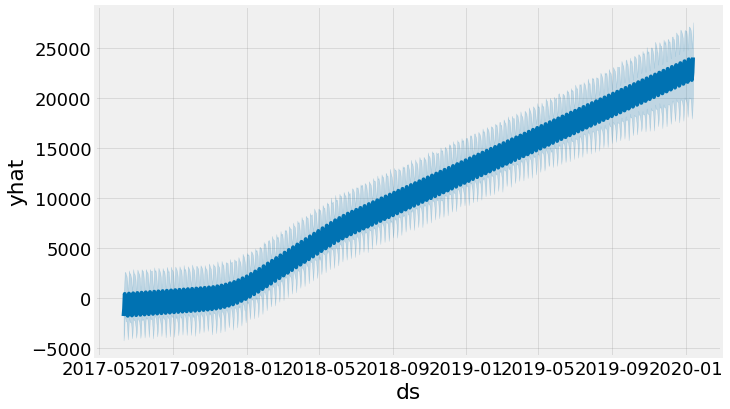

In [21]:
model.plot_forecast_component(df_predicted, name='yhat')

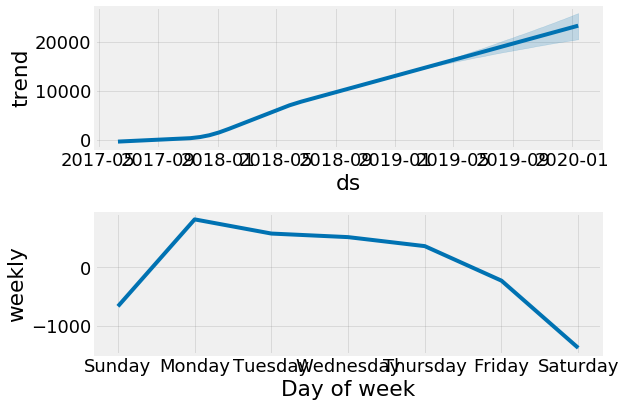

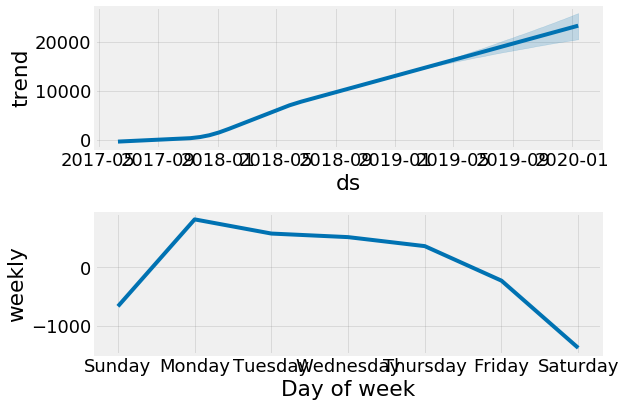

In [18]:
model.plot_components(df_predicted)

In [33]:
data = pd.read_csv('../plotly/building_one.csv', header=[0,1], index_col=0)
data.index = pd.to_datetime(data.index)

In [34]:
data.head()

type                StaticPressure                 Energy      Steam  \
sensor                           1         2            3          4   
measured_at                                                            
2017-12-14 11:00:00       0.806723  1.500570  6035.214040  13.164377   
2017-12-14 11:15:00       0.789395  1.490740  6182.405506  13.003065   
2017-12-14 11:30:00       0.792908  1.473761  6035.187942  12.617836   
2017-12-14 11:45:00       0.790165  1.485213  6035.192571  12.419816   
2017-12-14 12:00:00       0.786861  1.482015  6035.198581  12.975920   

type                            
sensor                       5  
measured_at                     
2017-12-14 11:00:00  10.367290  
2017-12-14 11:15:00   9.801097  
2017-12-14 11:30:00   9.794436  
2017-12-14 11:45:00   9.597848  
2017-12-14 12:00:00  10.041990

In [41]:
energy = data['Energy'].reset_index()
energy.rename(columns={'measured_at': 'ds', '3': 'y'}, inplace=True)

In [42]:
model = fbprophet.Prophet()
model.fit(energy)

INFO:fbprophet.forecaster:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
C:\Users\willk\Anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [43]:
energy_future = model.make_future_dataframe(periods=365)
energy_predicted = model.predict(energy_future)

In [44]:
energy_predicted.iplot(x='ds', y='yhat')